#XG Boost is one of the best Machine Learning Algorithms for Time Series Forecasting


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import plotly.express as px

from sklearn.model_selection import TimeSeriesSplit

from sklearn.metrics import mean_squared_error
import xgboost as xgb
#XGB works very well with changes in Data over time.

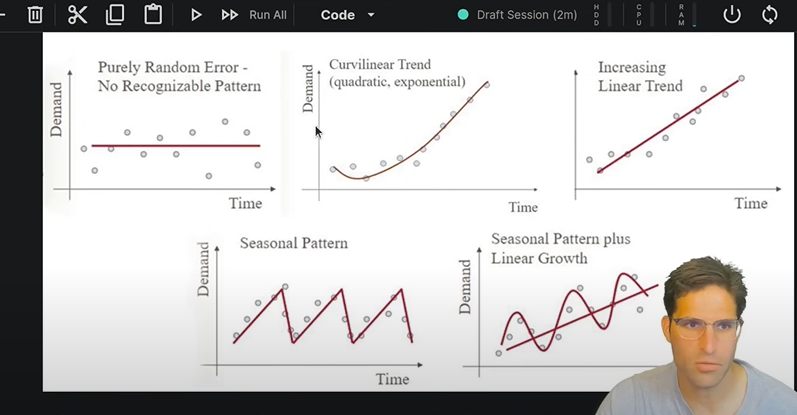

In [2]:
from IPython.display import Image
Image(filename=r"C:\Users\hemil\OneDrive\Desktop\Data Analyst\EDA PYTHON(JUPYTER NOTEBOOK)+ ML\ELECTRICITY USAGE PREDICTION\Screenshot added to Jupyter Notebook.png")


In [3]:
PJME_MW=pd.read_csv(r"C:\Users\hemil\OneDrive\Desktop\Data Analyst\EDA PYTHON(JUPYTER NOTEBOOK)+ ML\ELECTRICITY USAGE PREDICTION\DATASET\PJME_hourly.csv")
PJME_MW

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0
...,...,...
145361,2018-01-01 20:00:00,44284.0
145362,2018-01-01 21:00:00,43751.0
145363,2018-01-01 22:00:00,42402.0
145364,2018-01-01 23:00:00,40164.0


In [4]:
PJME_MW.shape

(145366, 2)

In [5]:
PJME_MW.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145366 entries, 0 to 145365
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   Datetime  145366 non-null  object 
 1   PJME_MW   145366 non-null  float64
dtypes: float64(1), object(1)
memory usage: 2.2+ MB


In [6]:
# Convert 'Datetime' column to datetime type (if it's not already)
PJME_MW['Datetime'] = pd.to_datetime(PJME_MW['Datetime'])

In [7]:
PJME_MW.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145366 entries, 0 to 145365
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   Datetime  145366 non-null  datetime64[ns]
 1   PJME_MW   145366 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 2.2 MB


In [8]:
PJME_MW= PJME_MW.reset_index()  # Reset the index to make 'Datetime' a column

In [9]:
PJME_MW.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145366 entries, 0 to 145365
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   index     145366 non-null  int64         
 1   Datetime  145366 non-null  datetime64[ns]
 2   PJME_MW   145366 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 3.3 MB


In [10]:
# Create the interactive plot using the reset DataFrame
px.line(PJME_MW, x='Datetime', y='PJME_MW', title='PJME_MW VS Time')

In [11]:
#Dropping all the outliers who satisfy the below mentioned criteria
PJME_MW = PJME_MW[~(PJME_MW['PJME_MW'] < 20000) | (PJME_MW['PJME_MW'] > 56000)]
PJME_MW

,index,Datetime,PJME_MW
0,0,2002-12-31 01:00:00,26498.0
1,1,2002-12-31 02:00:00,25147.0
2,2,2002-12-31 03:00:00,24574.0
3,3,2002-12-31 04:00:00,24393.0
4,4,2002-12-31 05:00:00,24860.0
...,...,...,...
145361,145361,2018-01-01 20:00:00,44284.0
145362,145362,2018-01-01 21:00:00,43751.0
145363,145363,2018-01-01 22:00:00,42402.0
145364,145364,2018-01-01 23:00:00,40164.0


In [12]:
#Train/Test split
PJME_MW

,index,Datetime,PJME_MW
0,0,2002-12-31 01:00:00,26498.0
1,1,2002-12-31 02:00:00,25147.0
2,2,2002-12-31 03:00:00,24574.0
3,3,2002-12-31 04:00:00,24393.0
4,4,2002-12-31 05:00:00,24860.0
...,...,...,...
145361,145361,2018-01-01 20:00:00,44284.0
145362,145362,2018-01-01 21:00:00,43751.0
145363,145363,2018-01-01 22:00:00,42402.0
145364,145364,2018-01-01 23:00:00,40164.0


In [13]:
#Feature Creation(It helps to make data analysis easier)
#(Also It helps while you want to make data cleaner for Giving it to machine learning Algorithm)
PJME_MW['Year'] = PJME_MW['Datetime'].dt.year
PJME_MW['DayOfMonth']=PJME_MW['Datetime'].dt.day
PJME_MW['Month']=PJME_MW['Datetime'].dt.month
PJME_MW['Hour']=PJME_MW['Datetime'].dt.hour
PJME_MW['DayOfWeek']=PJME_MW['Datetime'].dt.dayofweek
PJME_MW['Hour']=PJME_MW['Datetime'].dt.hour
PJME_MW['DayOfYear']=PJME_MW['Datetime'].dt.dayofyear
PJME_MW['Quarter']=PJME_MW['Datetime'].dt.quarter

PJME_MW.info()


<class 'pandas.core.frame.DataFrame'>
Index: 145178 entries, 0 to 145365
Data columns (total 10 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   index       145178 non-null  int64         
 1   Datetime    145178 non-null  datetime64[ns]
 2   PJME_MW     145178 non-null  float64       
 3   Year        145178 non-null  int32         
 4   DayOfMonth  145178 non-null  int32         
 5   Month       145178 non-null  int32         
 6   Hour        145178 non-null  int32         
 7   DayOfWeek   145178 non-null  int32         
 8   DayOfYear   145178 non-null  int32         
 9   Quarter     145178 non-null  int32         
dtypes: datetime64[ns](1), float64(1), int32(7), int64(1)
memory usage: 8.3 MB


In [14]:
PJME_MW_TRAIN=PJME_MW[PJME_MW['Datetime']<'2015-1-1 05:00:00']
PJME_MW_TEST=PJME_MW[PJME_MW['Datetime']>'2015-1-1 05:00:00']

# Aggregate PJME_MW by year (e.g., mean for each year)
train_yearly = PJME_MW_TRAIN.groupby('Year')['PJME_MW'].mean().reset_index()
test_yearly = PJME_MW_TEST.groupby('Year')['PJME_MW'].mean().reset_index()


In [15]:
PJME_MW_TRAIN.info()

<class 'pandas.core.frame.DataFrame'>
Index: 113813 entries, 0 to 122666
Data columns (total 10 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   index       113813 non-null  int64         
 1   Datetime    113813 non-null  datetime64[ns]
 2   PJME_MW     113813 non-null  float64       
 3   Year        113813 non-null  int32         
 4   DayOfMonth  113813 non-null  int32         
 5   Month       113813 non-null  int32         
 6   Hour        113813 non-null  int32         
 7   DayOfWeek   113813 non-null  int32         
 8   DayOfYear   113813 non-null  int32         
 9   Quarter     113813 non-null  int32         
dtypes: datetime64[ns](1), float64(1), int32(7), int64(1)
memory usage: 6.5 MB


In [16]:
PJME_MW_TEST.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31364 entries, 113927 to 145365
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   index       31364 non-null  int64         
 1   Datetime    31364 non-null  datetime64[ns]
 2   PJME_MW     31364 non-null  float64       
 3   Year        31364 non-null  int32         
 4   DayOfMonth  31364 non-null  int32         
 5   Month       31364 non-null  int32         
 6   Hour        31364 non-null  int32         
 7   DayOfWeek   31364 non-null  int32         
 8   DayOfYear   31364 non-null  int32         
 9   Quarter     31364 non-null  int32         
dtypes: datetime64[ns](1), float64(1), int32(7), int64(1)
memory usage: 1.8 MB


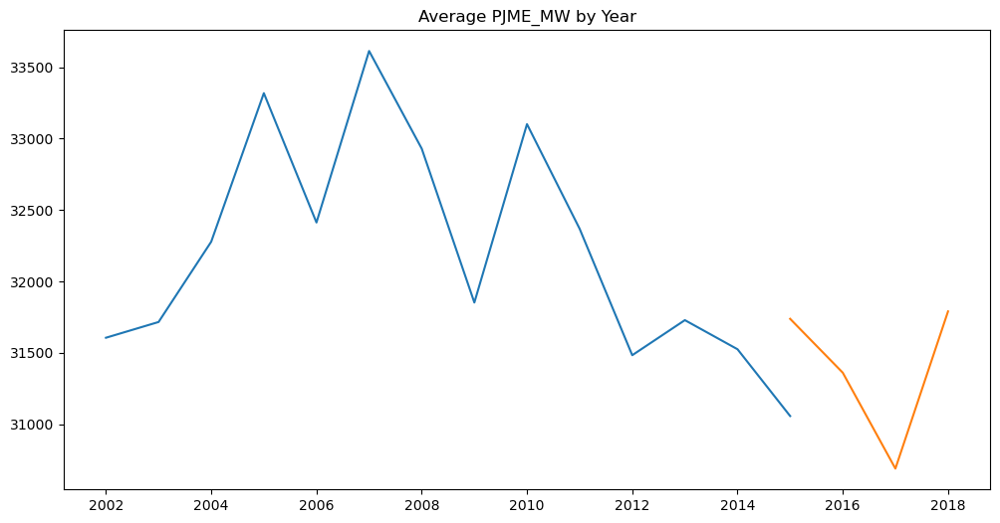

In [17]:
# Create a single plot
plt.figure(figsize=(12, 6))

# Plot training data
plt.plot(train_yearly['Year'], train_yearly['PJME_MW'], label='Train Data')

# Plot test data
plt.plot(test_yearly['Year'], test_yearly['PJME_MW'], label='Test Data')

# Add titles and labels
plt.title('Average PJME_MW by Year')

plt.show()


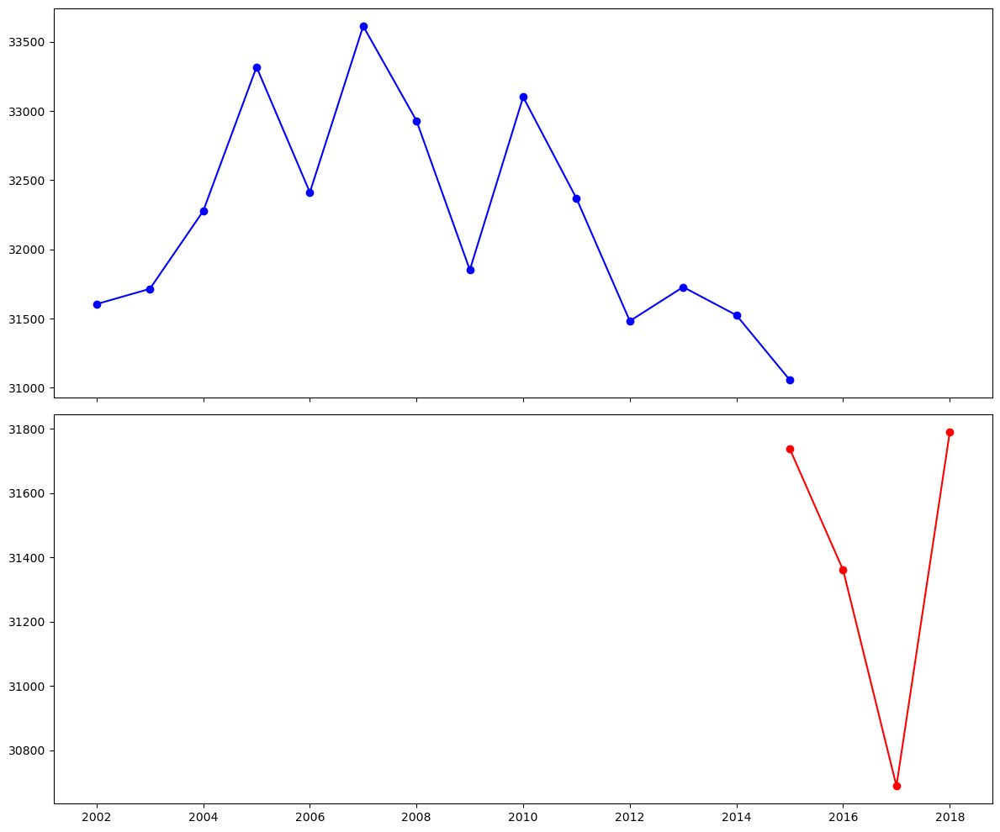

In [18]:

# Create subplots
fig,ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 10), sharex=True)

# Plot training data
ax[0].plot(train_yearly['Year'], train_yearly['PJME_MW'], marker='o', linestyle='-', color='b')

# Plot test data
ax[1].plot(test_yearly['Year'], test_yearly['PJME_MW'], marker='o', linestyle='-', color='r')

# Adjust layout
plt.tight_layout()
plt.show()


In [19]:
#Checking for weekly Trend

PJME_MW_WEEKLY = PJME_MW[(PJME_MW['Datetime'] > '2010-01-01 05:00:00') & (PJME_MW['Datetime'] < '2010-01-08 05:00:00')]
PJME_MW_WEEKLY['Day'] = PJME_MW['Datetime'].dt.day

PJME_MW_WEEKLY


C:\Users\hemil\AppData\Local\Temp\ipykernel_11772\1409790272.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,index,Datetime,PJME_MW,Year,DayOfMonth,Month,Hour,DayOfWeek,DayOfYear,Quarter,Day
78677,78677,2010-01-08 01:00:00,31334.0,2010,8,1,1,4,8,1,8
78678,78678,2010-01-08 02:00:00,30447.0,2010,8,1,2,4,8,1,8
78679,78679,2010-01-08 03:00:00,30098.0,2010,8,1,3,4,8,1,8
78680,78680,2010-01-08 04:00:00,30221.0,2010,8,1,4,4,8,1,8
78701,78701,2010-01-07 01:00:00,32194.0,2010,7,1,1,3,7,1,7
...,...,...,...,...,...,...,...,...,...,...,...
78864,78864,2010-01-01 20:00:00,35385.0,2010,1,1,20,4,1,1,1
78865,78865,2010-01-01 21:00:00,35105.0,2010,1,1,21,4,1,1,1
78866,78866,2010-01-01 22:00:00,34309.0,2010,1,1,22,4,1,1,1
78867,78867,2010-01-01 23:00:00,32956.0,2010,1,1,23,4,1,1,1


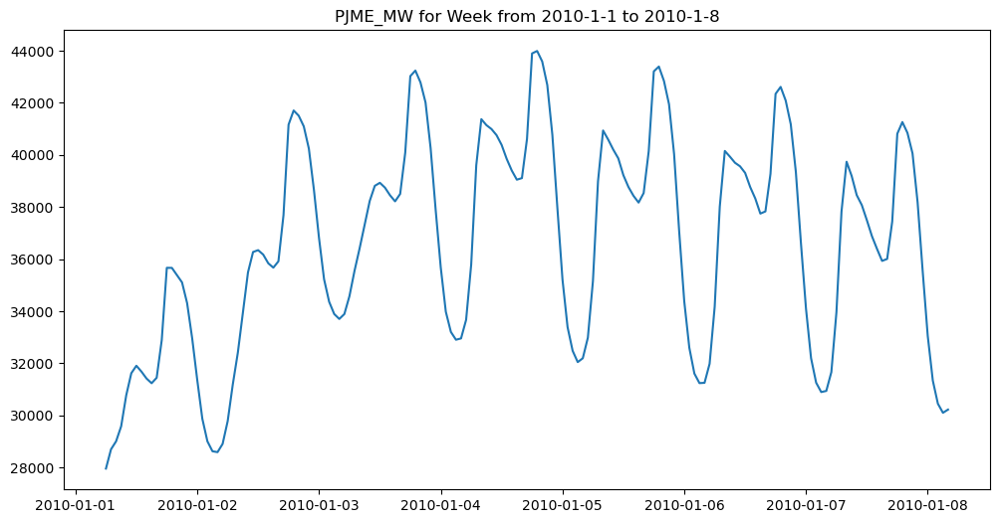

In [20]:
PJME_MW_WEEKLY = PJME_MW_WEEKLY.sort_values(by='Datetime')

# Create a single plot
plt.figure(figsize=(12, 6))

# Plot training data
plt.plot(PJME_MW_WEEKLY['Datetime'], PJME_MW_WEEKLY['PJME_MW'])

# Add titles and labels
plt.title('PJME_MW for Week from 2010-1-1 to 2010-1-8')

plt.show()



In [21]:
#Feature Creation(It helps to make data analysis easier)
#(Also It helps while you want to make data cleaner for Giving it to machine learning Algorithm)
PJME_MW['DayOfMonth']=PJME_MW['Datetime'].dt.day
PJME_MW['Month']=PJME_MW['Datetime'].dt.month
PJME_MW['Hour']=PJME_MW['Datetime'].dt.hour
PJME_MW['DayOfWeek']=PJME_MW['Datetime'].dt.dayofweek
PJME_MW['Hour']=PJME_MW['Datetime'].dt.hour
PJME_MW['DayOfYear']=PJME_MW['Datetime'].dt.dayofyear
PJME_MW['Quarter']=PJME_MW['Datetime'].dt.quarter


In [22]:
PJME_MW['Hour'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23,  0])

In [23]:
# Replace 0 with 24 in the 'Hour' column
PJME_MW['Hour'] = PJME_MW['Hour'].replace(0, 24)

PJME_MW['Hour'].unique()


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24])

In [24]:
PJME_MW

,index,Datetime,PJME_MW,Year,DayOfMonth,Month,Hour,DayOfWeek,DayOfYear,Quarter
0,0,2002-12-31 01:00:00,26498.0,2002,31,12,1,1,365,4
1,1,2002-12-31 02:00:00,25147.0,2002,31,12,2,1,365,4
2,2,2002-12-31 03:00:00,24574.0,2002,31,12,3,1,365,4
3,3,2002-12-31 04:00:00,24393.0,2002,31,12,4,1,365,4
4,4,2002-12-31 05:00:00,24860.0,2002,31,12,5,1,365,4
...,...,...,...,...,...,...,...,...,...,...
145361,145361,2018-01-01 20:00:00,44284.0,2018,1,1,20,0,1,1
145362,145362,2018-01-01 21:00:00,43751.0,2018,1,1,21,0,1,1
145363,145363,2018-01-01 22:00:00,42402.0,2018,1,1,22,0,1,1
145364,145364,2018-01-01 23:00:00,40164.0,2018,1,1,23,0,1,1


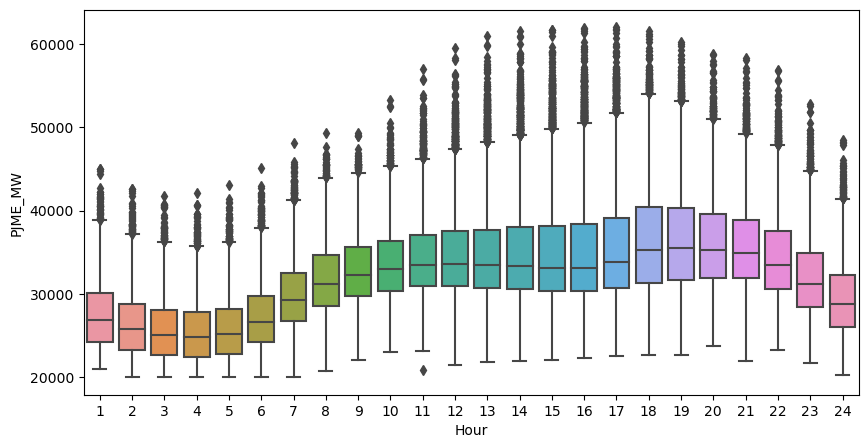

In [25]:
#Visualize our feature/Target Relationship
plt.figure(figsize=(10,5))
sns.boxplot(data=PJME_MW,x='Hour',y='PJME_MW')
plt.show()
#You can infer many thing from this chart,peak consumption is during 6:00 pm
#least consumption is during Early Morning and Night.

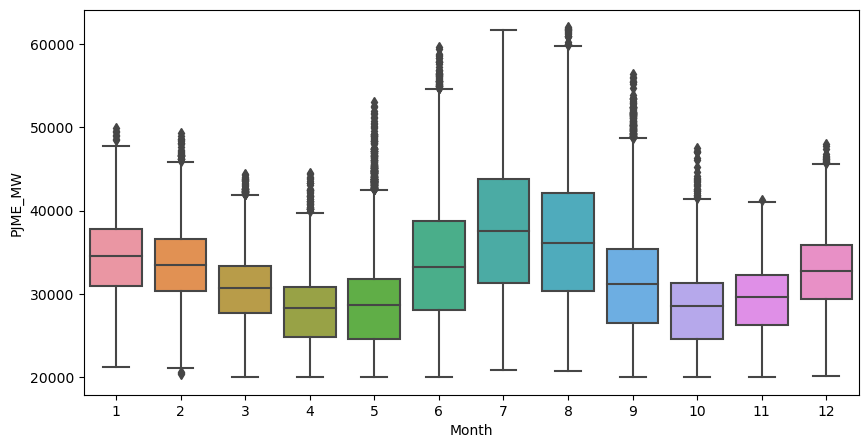

In [26]:
plt.figure(figsize=(10,5))
sns.boxplot(data=PJME_MW,x='Month',y='PJME_MW')
plt.show()


In [27]:
PJME_MW_TRAIN.columns
PJME_MW_TRAIN

,index,Datetime,PJME_MW,Year,DayOfMonth,Month,Hour,DayOfWeek,DayOfYear,Quarter
0,0,2002-12-31 01:00:00,26498.0,2002,31,12,1,1,365,4
1,1,2002-12-31 02:00:00,25147.0,2002,31,12,2,1,365,4
2,2,2002-12-31 03:00:00,24574.0,2002,31,12,3,1,365,4
3,3,2002-12-31 04:00:00,24393.0,2002,31,12,4,1,365,4
4,4,2002-12-31 05:00:00,24860.0,2002,31,12,5,1,365,4
...,...,...,...,...,...,...,...,...,...,...
113926,113926,2014-01-02 00:00:00,30159.0,2014,2,1,0,3,2,1
122663,122663,2015-01-01 01:00:00,31647.0,2015,1,1,1,3,1,1
122664,122664,2015-01-01 02:00:00,30755.0,2015,1,1,2,3,1,1
122665,122665,2015-01-01 03:00:00,30189.0,2015,1,1,3,3,1,1


In [28]:
# Correctly selecting multiple columns using double square brackets
X_Train = PJME_MW_TRAIN[['Year', 'DayOfMonth', 'Month', 'Hour', 'DayOfWeek', 'DayOfYear', 'Quarter']]
Y_Train = PJME_MW_TRAIN['PJME_MW']
X_Test = PJME_MW_TEST[['Year', 'DayOfMonth', 'Month', 'Hour', 'DayOfWeek', 'DayOfYear', 'Quarter']]
Y_Test = PJME_MW_TEST['PJME_MW']



In [29]:
from sklearn.model_selection import RandomizedSearchCV
import xgboost as xgb

# Simplified parameter grid
param_grid = {
    'n_estimators': [100, 500, 1000],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'gamma': [0, 0.1, 0.5]
}

# Initialize the XGBoost regressor
model = xgb.XGBRegressor()

# Use RandomizedSearchCV to search over the parameter grid
random_search = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_grid,
    n_iter=10,  # Reduced number of combinations
    scoring='neg_mean_squared_error',
    cv=2,  # 2-fold cross-validation for quicker execution
    verbose=2,
    n_jobs=-1
)

# Fit the model to your training data
random_search.fit(X_Train, Y_Train)

# Print the best parameters found
print("Best parameters found: ", random_search.best_params_)


Fitting 2 folds for each of 10 candidates, totalling 20 fits
Best parameters found:  {'subsample': 0.8, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 5, 'learning_rate': 0.05, 'gamma': 0, 'colsample_bytree': 0.8}


xgb.XGBRegressor(): Creates an XGBoost model for regression.

n_estimator=1000: Trains up to 1000 trees.

early_stopping=50: Stops training if no improvement is seen on the validation set after 50 rounds.

Model.fit(): Fits the model using the training data, and evaluates it on both training and test data.

verbose=True: Prints progress messages showing the performance on both the training and validation sets during training.

Learning_Rate=The learning rate is a hyperparameter that controls the size of updates made to the model in each boosting iteration.
Smaller learning rates lead to better generalization (lower risk of overfitting) but require more iterations (trees).
Larger learning rates make faster progress but can overshoot optimal solutions and lead to overfitting.

A small learning rate means the contributions of each tree are scaled down, so the model updates its predictions more cautiously. Conversely, a larger learning rate makes each tree's predictions have a bigger impact.




Gradient Boosting is a powerful machine learning technique used for both classification and regression tasks. It is based on the idea of ensemble learning, where multiple models (typically decision trees) are combined to make predictions. The key idea behind gradient boosting is that new models are created to correct the errors made by the previous models.

The "boosting" part means that models are added sequentially, each one correcting the errors of its predecessor. The "gradient" part refers to the optimization process: it uses gradient descent to minimize a specific loss function (like Mean Squared Error for regression or Log Loss for classification).

In simple terms:

Gradient boosting builds models in a stepwise fashion, where each new model focuses on correcting the mistakes of the previous one.
The overall model improves iteratively until the errors are minimized.


In [30]:
#Forecating and checking accuracy
PJME_MW_TEST['Prediction']=random_search.predict(X_Test)

C:\Users\hemil\AppData\Local\Temp\ipykernel_11772\386026351.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



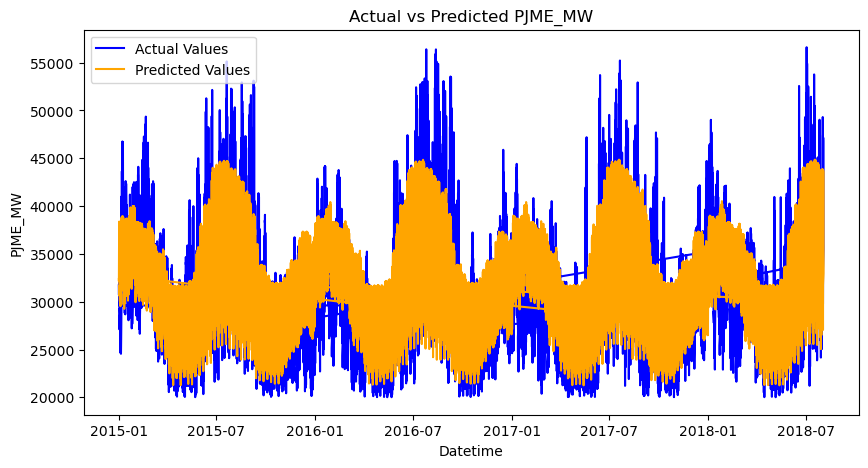

In [31]:

# Create a figure with specific size
plt.figure(figsize=(10, 5))

# Plot actual values
plt.plot(PJME_MW_TEST['Datetime'], PJME_MW_TEST['PJME_MW'], label='Actual Values', color='blue')

# Plot predicted values
plt.plot(PJME_MW_TEST['Datetime'], PJME_MW_TEST['Prediction'], label='Predicted Values', color='orange')

# Add titles and labels
plt.title('Actual vs Predicted PJME_MW')
plt.xlabel('Datetime')
plt.ylabel('PJME_MW')

# Show legend
plt.legend()

# Display the plot
plt.show()


In [32]:
#Creating a basic model Using XGB Regressor
Model=xgb.XGBRegressor(n_estimator=1000,learning_rate=0.1)
Model.fit(X_Train,Y_Train,eval_set=[(X_Train,Y_Train),(X_Test,Y_Test)],verbose=100)

[0]	validation_0-rmse:6000.34386	validation_1-rmse:6095.83016


C:\Users\hemil\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning:

[17:40:36] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "n_estimator" } are not used.




[99]	validation_0-rmse:2282.58037	validation_1-rmse:3993.16536


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimator=1000, n_estimators=None,
             n_jobs=None, num_parallel_tree=None, ...)

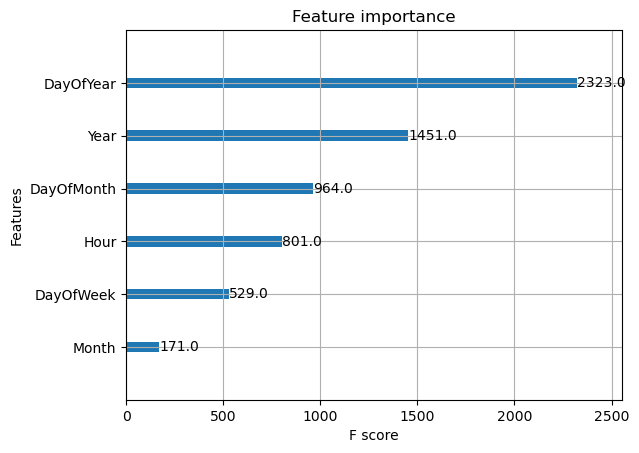

In [33]:
Model.feature_importances_

xgb.plot_importance(Model, importance_type='weight')
plt.show()


In [34]:
#Forecating and checking accuracy
PJME_MW_TEST['Prediction_Basic']=Model.predict(X_Test)

C:\Users\hemil\AppData\Local\Temp\ipykernel_11772\3907399222.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



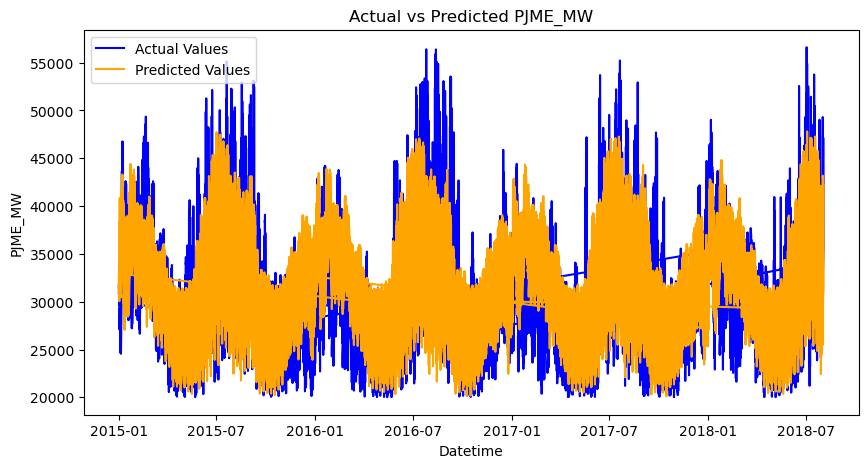

In [35]:
# Create a figure with specific size
plt.figure(figsize=(10, 5))

# Plot actual values
plt.plot(PJME_MW_TEST['Datetime'], PJME_MW_TEST['PJME_MW'], label='Actual Values', color='blue')

# Plot predicted values
plt.plot(PJME_MW_TEST['Datetime'], PJME_MW_TEST['Prediction_Basic'], label='Predicted Values', color='orange')

# Add titles and labels
plt.title('Actual vs Predicted PJME_MW')
plt.xlabel('Datetime')
plt.ylabel('PJME_MW')

# Show legend
plt.legend()

# Display the plot
plt.show()


In [36]:
# Create an interactive line plot using Plotly Express
fig = px.line(PJME_MW_TEST, x='Datetime', y=['PJME_MW', 'Prediction'], 
              labels={'value': 'PJME_MW', 'variable': 'Legend'},
              title='Actual vs Predicted PJME_MW')

# Update layout for better presentation
fig.update_layout(
    xaxis_title='Datetime',
    yaxis_title='PJME_MW',
    legend_title='',
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)

# Display the interactive plot
fig.show()


In [37]:
# Calculate Root mean squared error for HyperParameter Tuned Models
rmse =np.sqrt(mean_squared_error(PJME_MW_TEST['PJME_MW'], PJME_MW_TEST['Prediction']))
print(f"Root Mean Squared Error (RMSE): {rmse}")


Root Mean Squared Error (RMSE): 3713.8834520686046


In [38]:
# Calculate Root mean squared error for Basic Model
rmse =np.sqrt(mean_squared_error(PJME_MW_TEST['PJME_MW'], PJME_MW_TEST['Prediction_Basic']))
print(f"Root Mean Squared Error (RMSE): {rmse}")


Root Mean Squared Error (RMSE): 3993.1653572995415


In [39]:
#You can add more feature like weather Forecast,Holidays etc(To make this model more robust)
#Also you can use more machine learning Time series Algorithms.